In [6]:
import psycopg2
import csv
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import squareform, pdist
import pandas as pd
from psycopg2.extras import RealDictCursor
from scipy.stats import pearsonr
import scipy.sparse as sp

In [10]:
conn = psycopg2.connect(
    host="localhost",
    port=5432,
    dbname="test",
    user="siyuanzhao",
    cursor_factory=RealDictCursor
)
chromosome_name = 'chr8'
cell_line = 'IMR'
sequences = {"start": 127300000, "end": 128300000}

In [4]:
position_file = "position.csv"

cur = conn.cursor()
with open(position_file, mode='r', encoding='utf-8') as f:
    reader = csv.DictReader(f)
    for row in reader:
        pid = row["pid"]
        cell_line = row["cell_line"]
        chrid = row["chrid"]
        sampleid = row["sampleid"]
        start_value = row["start_value"]
        end_value = row["end_value"]
        x = row["x"]
        y = row["y"]
        z = row["z"]
        insert_time = row["insert_time"]
        
        insert_query = """
            INSERT INTO position (pid, cell_line, chrid, sampleid, start_value, end_value, x, y, z, insert_time)
            VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s)
        """

        cur.execute(insert_query, (pid, cell_line, chrid, sampleid, start_value, end_value, x, y, z, insert_time))

conn.commit()
cur.close()
conn.close()

In [8]:
def get_position_data(conn, chromosome_name, cell_line, sequences):
    cur = conn.cursor()
    cur.execute(
        """
        SELECT *
        FROM position
        WHERE chrid = %s
        AND cell_line = %s
        AND start_value = %s
        AND end_value = %s
        ORDER BY sampleid, pid
    """,
        (chromosome_name, cell_line, sequences["start"], sequences["end"]),
    )
    data = cur.fetchall()
    cur.close()
    return data

In [20]:
data = sp.load_npz("IMR_chr8_127300000_128300000.npz")
features = data.toarray()
df_features = pd.DataFrame(features)

In [21]:
df_features

,0,1,2,3,4,5,6,7,8,9,...,19890,19891,19892,19893,19894,19895,19896,19897,19898,19899
0,34.292301,43.448601,71.992599,92.099701,117.505997,139.028000,149.031998,172.617996,163.171997,187.403000,...,34.292301,48.470001,76.734200,81.655602,34.292301,61.972801,65.075699,34.292301,34.436100,34.292301
1,34.292301,53.988300,63.156101,61.821800,42.653198,50.838799,73.776703,81.757896,67.066902,100.143997,...,34.292301,37.461601,54.188400,80.269997,34.292301,34.932400,68.773102,34.292301,56.798500,34.292301
2,34.292301,52.173599,75.480904,89.674698,80.920601,98.934601,117.105003,120.806000,99.415604,126.188004,...,34.292301,60.541698,51.981602,77.396103,34.292301,38.506100,52.966000,34.292301,46.303200,34.292301
3,34.292301,52.173599,75.480904,89.674698,80.920601,98.934601,117.105003,120.806000,99.415604,126.188004,...,34.292301,52.073799,81.114304,82.979401,34.292301,65.782501,81.199203,34.292301,54.134998,34.292301
4,34.292301,53.988300,63.156101,61.821800,42.653198,50.838799,73.776703,81.757896,67.066902,100.143997,...,34.292301,51.936298,68.042900,52.123699,34.292301,60.491501,63.423302,34.292301,48.195499,34.292301
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,34.292301,65.714500,92.852997,99.742203,79.658302,91.291397,121.852997,139.630005,120.545998,143.257004,...,34.292301,41.052799,52.773602,76.498398,34.292301,64.334602,95.598297,34.292301,66.665001,34.292301
4996,34.292301,46.336700,66.611397,82.911598,96.405899,129.664993,134.968002,149.740005,146.319000,118.596001,...,34.292301,57.389599,81.111298,68.815300,34.292301,66.161797,64.770103,34.292301,47.578602,34.292301
4997,34.292301,46.336700,66.611397,82.911598,96.405899,129.664993,134.968002,149.740005,146.319000,118.596001,...,34.292301,61.584202,87.276001,83.746696,34.292301,66.666801,66.139198,34.292301,39.341702,34.292301
4998,34.292301,46.336700,66.611397,82.911598,96.405899,129.664993,134.968002,149.740005,146.319000,118.596001,...,34.292301,41.507301,58.491001,40.737499,34.292301,66.675201,62.978802,34.292301,44.936901,34.292301


In [24]:
first_row_array = df_features.iloc[3].to_numpy()
first_row_array

array([34.2923, 52.1736, 75.4809, ..., 34.2923, 54.135 , 34.2923],
      dtype=float32)

In [11]:
position = get_position_data(conn, chromosome_name, cell_line, sequences)
position_df = pd.DataFrame(position)
position_df

,pid,chrid,cell_line,sampleid,x,y,z,start_value,end_value,insert_time
0,31133701,chr8,IMR,0,141.319264,-56.239365,-463.502716,127300000,128300000,2025-04-04 19:24:57
1,31133702,chr8,IMR,0,133.859610,-82.987356,-443.381580,127300000,128300000,2025-04-04 19:24:57
2,31133703,chr8,IMR,0,154.993296,-97.390120,-466.226475,127300000,128300000,2025-04-04 19:24:57
3,31133704,chr8,IMR,0,168.714612,-120.023035,-444.421931,127300000,128300000,2025-04-04 19:24:57
4,31133705,chr8,IMR,0,189.848298,-134.425800,-467.266826,127300000,128300000,2025-04-04 19:24:57
...,...,...,...,...,...,...,...,...,...,...
999995,32108696,chr8,IMR,4999,-46.108378,-58.296903,348.073384,127300000,128300000,2025-04-04 19:26:11
999996,32108697,chr8,IMR,4999,-45.959840,-42.522447,317.624968,127300000,128300000,2025-04-04 19:26:11
999997,32108698,chr8,IMR,4999,-71.456921,-30.863066,297.878595,127300000,128300000,2025-04-04 19:26:11
999998,32108699,chr8,IMR,4999,-103.804128,-23.318761,306.405215,127300000,128300000,2025-04-04 19:26:11


In [ ]:
distance_results = {}

for sampleid, group in position_df.groupby('sampleid'):
    coords = group[['x', 'y', 'z']].to_numpy()
    dists = pdist(coords)
    distance_results[sampleid] = dists

In [27]:
distance_results[3]

array([34.29229508, 52.17355392, 75.48091562, ..., 34.29229589,
       54.1349993 , 34.29229546])

In [28]:
print(np.allclose(distance_results[3], first_row_array))

True


In [31]:
def upper_tri_index(i, j, N):
    """
    Maps (i, j) indices in an NxN matrix (i < j) to the index in the
    flattened upper triangle (excluding diagonal).
    
    Parameters:
        i (int): row index (must be less than j)
        j (int): column index
        N (int): total number of rows/columns in the square matrix
        
    Returns:
        int: index in the 1D flattened upper triangle array
    """
    if i >= j:
        raise ValueError("This function assumes i < j (upper triangle only).")
    return int(i * (N - 1) - (i * (i + 1)) // 2 + (j - i - 1))

idx = upper_tri_index(28, 32, 200)


In [32]:
idx

5169

In [37]:
triu_indices = np.triu_indices(200, k=1)
check_i = triu_indices[0][idx]
check_j = triu_indices[1][idx]
print(f"i: {check_i}, j: {check_j}")

i: 27, j: 175


In [35]:
print(min(df_features.iloc[:,idx]), max(df_features.iloc[:,idx]))

103.375 1298.0699462890625


{'bodies': [<matplotlib.collections.PolyCollection at 0x3c376b7c0>],
 'cmaxes': <matplotlib.collections.LineCollection at 0x3c376b0d0>,
 'cmins': <matplotlib.collections.LineCollection at 0x3c376ad40>,
 'cbars': <matplotlib.collections.LineCollection at 0x3c3768640>}

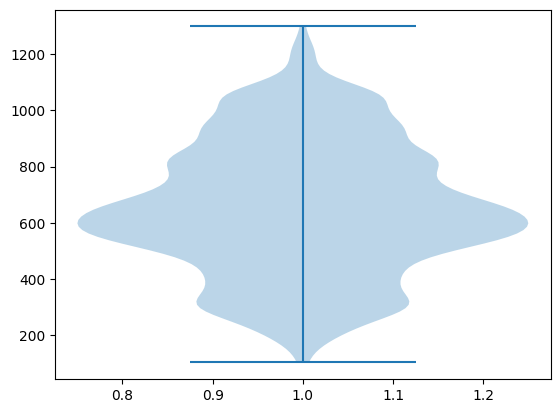

In [36]:
plt.violinplot(df_features.iloc[:,idx])